## Image segmentation analysis and unsupervised image multilabel segmentation with `OpenCV` , `scikit-image`, `scikit-learn`

---
---

### 1. Region of Interest (ROI) analyses from JSON - image annotator & binary mask generation
* Created using VGG image annotator https://www.robots.ox.ac.uk/~vgg/software/via/  (Default JSON export)
---
### 2. Unsupervised binary segmentation mask generation with image processing techniques and algorithms, training of classification unsupervised machine learning models with ROI region features in binary mask, annotation of predicted classes
* K-means
* Dirichlet Gaussian Mixture Model

In [3]:
# importar librerías
import cv2
import numpy as np
from PIL import Image, ImageTk
import os
Image.MAX_IMAGE_PIXELS = None
import pandas as pd
from skimage.measure import regionprops_table
from skimage.measure import regionprops
import json
from skimage.draw import disk
# import seaborn as sns

creación del df en el que se volcarán todos los datos

In [3]:
roi_analysis = pd.DataFrame()

properties_to_analyze = ("label", "centroid", "area", "area_convex", "eccentricity","intensity_mean","intensity_max", "intensity_min", "axis_minor_length", "axis_major_length")

In [4]:
dirmasks = "pwd/test2.json"

In [5]:
f = open(dirmasks, "r")
data = json.load(f)
data = data["_via_img_metadata"]

In [6]:
img_dir = "cwd/train/images"
mask_dir = "cwd/train/mask"

In [7]:
for key, value in data.items():
    
    filename = value["filename"]
    print(filename)
    img_path = f"{img_dir}\\{filename}"
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    
    h, w =img.shape
    
    
    regions = value["regions"]

    microspore_counter = 0
    proembryo_counter = 0

    # per region, segment and create a mask
    for region in regions:
        
        # if proembryo
        if region["region_attributes"]["name"] == "proembryo":
            
            mask = np.zeros((h,w))
            
            proembryo_counter = proembryo_counter + 1
            
            shape_attributes = region["shape_attributes"]
            xc = shape_attributes["cx"]
            yc = shape_attributes["cy"]
            radius = int(shape_attributes["r"])
            
            cv2.circle(mask, (xc,yc) , radius, 2, -1)

            mask = mask.astype(int)
            props = regionprops_table(
                            mask,
                            img,
                            properties=properties_to_analyze
                        )

            tmp_df_region = pd.DataFrame.from_dict(props)
            tmp_df_region["id"] = "proembryo_"+str(filename)+"_"+str(proembryo_counter)
            roi_analysis = pd.concat((roi_analysis, tmp_df_region), ignore_index=True)

            mask = np.zeros((h,w))
        
        # if microspore
        if region["region_attributes"]["name"] == "microspore":

            mask = np.zeros((h,w))
            microspore_counter = microspore_counter + 1
            
            shape_attributes = region["shape_attributes"]
            xpoints = shape_attributes["all_points_x"]
            ypoints = shape_attributes["all_points_y"]
    
            contours = []
            for x , y in zip(xpoints, ypoints):
                contours.append((x,y))
            contours = np.array(contours)
        
            cv2.drawContours(mask, [contours], -1, 1, -1)
            
            mask = mask.astype(int)
            props = regionprops_table(
                            mask,
                            img,
                            properties=properties_to_analyze
                        )

            tmp_df_region = pd.DataFrame.from_dict(props)
            tmp_df_region["id"] = "microspore_"+str(filename)+"_"+str(microspore_counter)
            roi_analysis = pd.concat((roi_analysis, tmp_df_region), ignore_index=True)

            mask = np.zeros((h,w))
        
        proembryo_counter = 0

c0002.tif.png
c0004.tif.png
c0005.tif.png
c0010.tif.png
c0011.tif.png
c0012.tif.png
c0017.tif.png
c0018.tif.png
c0019.tif.png
c0006.tif.png
c0007.tif.png
c0008.tif.png
c0009.tif.png
c0013.tif.png
c0014.tif.png
c0015.tif.png
c0016.tif.png


In [8]:
summary=roi_analysis.groupby("label").describe()

In [9]:
summary["intensity_mean"]

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
1,400.0,158.781698,7.429946,136.828834,154.048763,159.240511,164.434419,175.104038
2,650.0,165.782720,7.543398,128.111016,161.155111,165.549198,171.279052,185.066043


In [10]:
summary["intensity_min"]

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
1,400.0,98.355000,11.928945,65.0,90.0,97.5,105.0,134.0
2,650.0,111.844615,14.408807,64.0,102.0,112.0,122.0,154.0


C:\Users\Usuario\miniconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


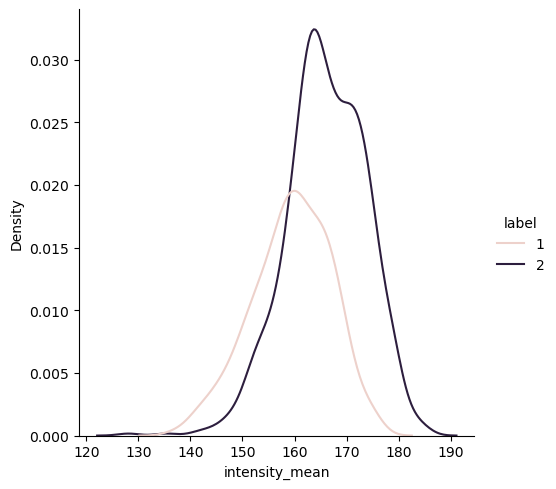

In [95]:
df = roi_analysis[["label", "intensity_mean"]]

sns.displot(df,x="intensity_mean", hue="label", kind="kde")

In [108]:
summary[["intensity_max"]]


intensity_max                                                         
              count        mean       std    min    25%    50%    75%    max
label                                                                       
1             480.0  189.527083  6.937786  168.0  185.0  190.0  194.0  206.0
2             758.0  191.411609  6.982482  168.0  187.0  192.0  197.0  207.0

In [100]:
summary["eccentricity"]

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
1,480.0,0.497824,0.113249,0.131478,0.423779,0.514752,0.573674,0.781740
2,758.0,0.005907,0.052128,0.000000,0.000000,0.000000,0.000000,0.734157


C:\Users\Usuario\miniconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


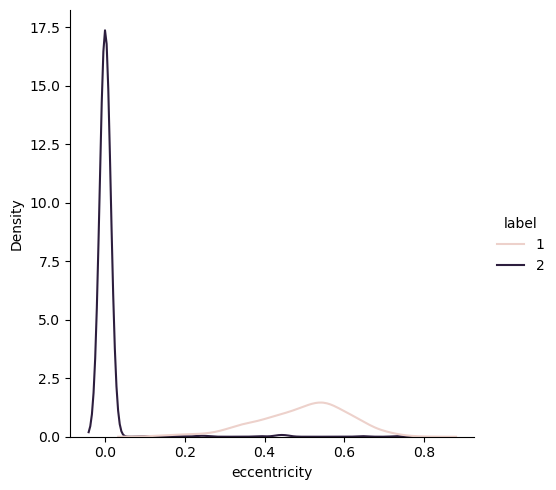

In [99]:
df = roi_analysis[["label", "eccentricity"]]

sns.displot(df,x="eccentricity", hue="label", kind="kde")

In [101]:
summary["area"]

,count,mean,std,min,25%,50%,75%,max
label,,,,,,,,
1,480.0,5824.385417,1037.260586,3244.0,5112.0,5691.0,6429.25,9389.0
2,758.0,10225.395778,2617.669842,4777.0,8173.0,10189.0,11681.00,21629.0


In [118]:
summary[["axis_minor_length"]]

axis_minor_length                                                \
                  count        mean        std        min         25%   
label                                                                   
1                 400.0   80.297333   7.798475  54.773073   75.359264   
2                 650.0  113.250925  14.323695  77.990504  102.012040   

                                           
              50%         75%         max  
label                                      
1       79.455436   85.675504  101.946859  
2      113.899419  123.921648  165.948742

In [119]:
summary[["axis_major_length"]]

axis_major_length                                                \
                  count        mean        std        min         25%   
label                                                                   
1                 400.0   93.944775   8.622965  74.746811   88.024883   
2                 650.0  113.356179  14.270889  77.990504  102.012040   

                                           
              50%         75%         max  
label                                      
1       93.320179   99.211735  124.561319  
2      113.899419  123.921648  165.948742

In [161]:
summary[["area"]]

area                                                                 \
       count          mean          std     min      25%      50%       75%   
label                                                                         
1      400.0   5888.057500  1027.935671  3440.0  5144.75   5777.0   6518.75   
2      650.0  10241.543077  2623.917889  4777.0  8173.00  10189.0  12061.00   

                
           max  
label           
1       8816.0  
2      21629.0

C:\Users\Usuario\miniconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


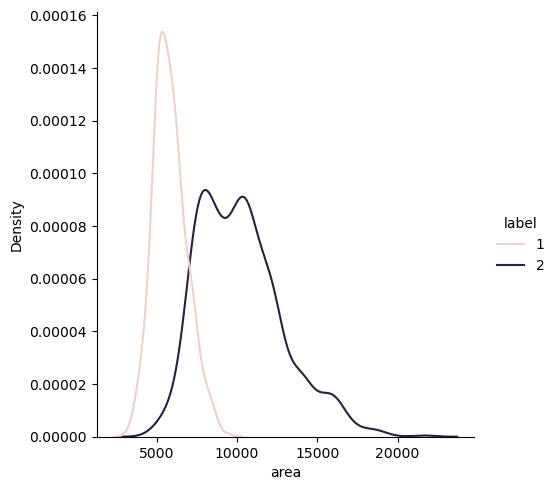

In [102]:
df = roi_analysis[["label", "area"]]

sns.displot(df,x="area", hue="label", kind="kde")

In [37]:
roi_analysis["label_true"] = list(map(lambda x:1 if x==2 else 0, roi_analysis.label.values.tolist()))

# Supervised learning alternative

Entrenar random forest con informacion roi_analysis

Con: Binary masks predicted by a SAM (Segment Anything Model), or other alternatives will not render ROIs with the exact region properties

In [38]:
from sklearn.ensemble import RandomForestClassifier

In [92]:
clf = RandomForestClassifier(max_depth=2, random_state=0)

In [93]:
from sklearn.model_selection import train_test_split
y = roi_analysis.label_true.values
X = roi_analysis[['area','eccentricity']].values.tolist()
X_train, X_test, y_train, y_test = train_test_split(X,y, random_state = 42)

In [94]:
clf.fit(X_train, y_train)
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

y_predict = clf.predict(X_test)
cm = confusion_matrix(y_test, y_predict)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                               display_labels=["proembryo", "microspore"])

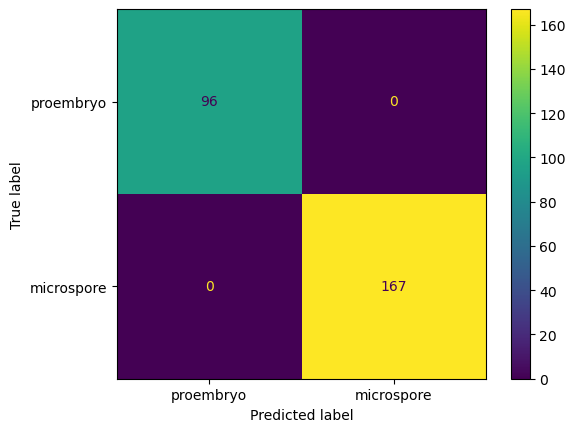

In [95]:
disp.plot()

plt.show()

# Unsupervised learning image segmentation

In [ ]:
# Leer la imagen
image = cv2.imread("cwd/image_train_example.png", cv2.IMREAD_GRAYSCALE)

Scikit-image contour find

In [ ]:
# try with SCIKIT CONTOUR FIND method

import numpy as np
import matplotlib.pyplot as plt
from skimage import measure
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import gaussian
from skimage.segmentation import active_contour




# Find contours at a constant value of 0.8
contours = measure.find_contours(image, 0.8)

# Display the image and plot all contours found
fig, ax = plt.subplots()
ax.imshow(image, cmap=plt.cm.gray)

for contour in contours:
    ax.plot(contour[:, 1], contour[:, 0], linewidth=2)

ax.axis('image')
ax.set_xticks([])
ax.set_yticks([])
plt.show()

In [137]:
s = np.linspace(0, 2 * np.pi, 100)
r = 197 + 100 * np.sin(s)
c = 724 + 100 * np.cos(s)
init = np.array([r, c]).T

snake = active_contour(
    gaussian(image, sigma=3, preserve_range=False),
    init,
    alpha=0.015,
    beta=10,
    gamma=0.001,
)

fig, ax = plt.subplots(figsize=(7, 7))
ax.imshow(image, cmap=plt.cm.gray)
ax.plot(init[:, 1], init[:, 0], '--r', lw=3)
ax.plot(snake[:, 1], snake[:, 0], '-b', lw=3)
ax.set_xticks([]), ax.set_yticks([])
ax.axis([0, img.shape[1], img.shape[0], 0])

plt.show()

Con: Cost in time and computation, irregular contour

**Preprocessing and Canny edge detection, OpenCV draw contours, erode/dilate remove_small_objects scikit-image postprocessing methods**

In [ ]:
# canny edge detection and contrast increase image preprocessing

import cv2
from skimage.morphology import erosion, dilation, opening, closing, white_tophat  # noqa
from skimage.morphology import black_tophat, white_tophat, skeletonize, convex_hull_image  # noqa
from skimage.morphology import remove_small_objects, remove_small_holes

from skimage.morphology import disk

p_image = cv2.convertScaleAbs(image, alpha=1.8, beta=-100)
p_image = remove_small_objects(p_image, min_size=100, connectivity=1)


blurred = cv2.GaussianBlur(p_image, (9, 9), 0)
# Detección de bordes utilizando el detector de Canny
#umin 50
footprint = disk(3)
edges = cv2.Canny(blurred, 20, 20)


image_p = closing(edges, footprint)

# Taking a matrix of size 5 as the kernel 
kernel = np.ones((2, 2), np.uint8) 
  


In [8]:
#ret,thresh = cv2.threshold(edges,,255,0)
contours, hierarchy = cv2.findContours(image_p, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)


In [10]:
# create binary mask with contour information
mask = np.zeros(image.shape)
cv2.drawContours(mask, contours, -1, 255, -1, maxLevel=2)

In [12]:
# Taking a matrix of size 5 as the kernel 
kernel = np.ones((2, 2), np.uint8) 
# 
# The first parameter is the original image, kernel is the matrix with which image is 
# convolved 
# and third parameter is the number of iterations, which will determine how much 
# you want to erode/dilate a given image. 

image_mask_second_iteration = np.array(mask, dtype="uint8")
image_mask_second_iteration = cv2.dilate(image_mask_second_iteration, kernel, iterations=2)
image_mask_second_iteration = closing(image_mask_second_iteration, footprint)
image_mask_second_iteration = closing(image_mask_second_iteration, footprint)

# reverse binary mask to remove small black objects
image_mask_second_iteration = image_mask_second_iteration != 255
image_mask_second_iteration = remove_small_objects(image_mask_second_iteration, min_size=100000, connectivity=1)
image_mask_second_iteration = remove_small_holes(image_mask_second_iteration, area_threshold=1000, connectivity=2)

# reverse binary mask to return ROI with True values
image_mask_second_iteration = image_mask_second_iteration != True


In [13]:
# Taking a matrix of size 5 as the kernel 
kernel = np.ones((7, 7), np.uint8) 

image_mask_second_iteration = np.array(image_mask_second_iteration, dtype=np.uint8) * 255
image_mask_second_iteration = cv2.erode(image_mask_second_iteration, kernel, iterations=2)

np.unique(image_mask_second_iteration)

array([  0, 255], dtype=uint8)

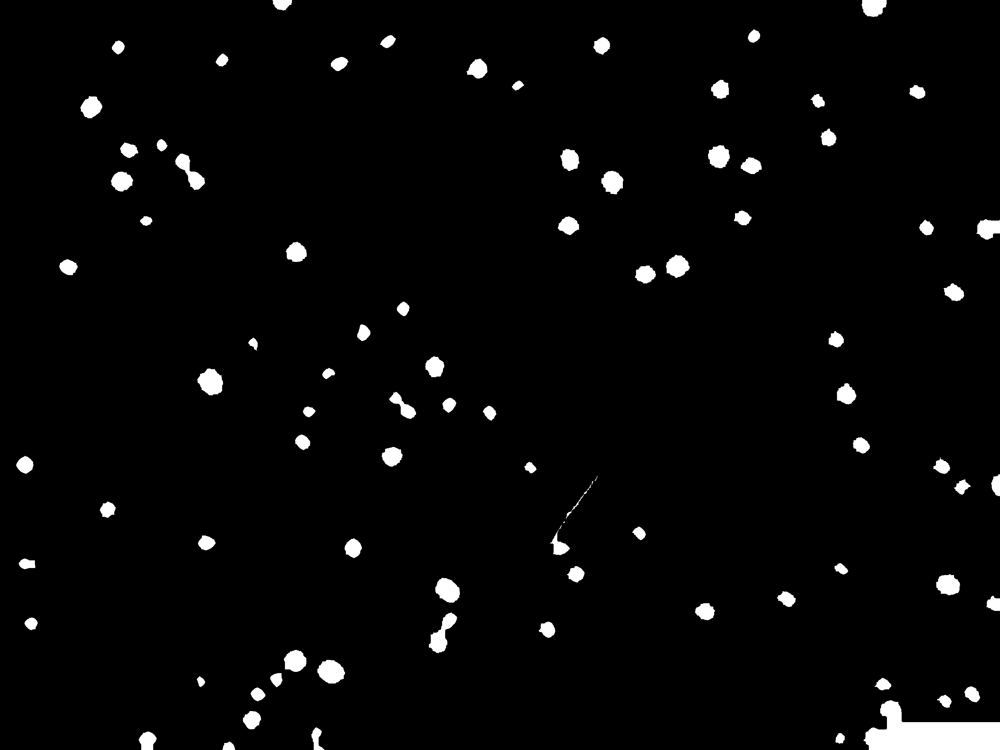

In [14]:
image_mask_second_iteration = cv2.erode(image_mask_second_iteration, kernel, iterations=2)
img = Image.fromarray(image_mask_second_iteration)

# Display with opencv
img


In [ ]:
contours, hierarchy = cv2.findContours(image_mask_second_iteration, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
mask3 = np.zeros(image_mask_second_iteration.shape)
cv2.drawContours(mask3, contours, -1, 255, -1, maxLevel=2)

In [16]:
df_after_analysis= pd.DataFrame()
df_after_ellipsis= pd.DataFrame()

**Analysis of unsupervised mask with regionprops** scikit-image method

In [17]:
import math

In [18]:
properties_to_analyze = ("label", "centroid", "area",  "eccentricity", "axis_major_length")

mask5 = np.ones(image.shape)
for contour in contours:
    mask_tmp = np.zeros(image.shape)
    
    cv2.drawContours(mask_tmp, [contour], -1, 1, -1)
    
    mask_tmp = mask_tmp.astype(int)
    props = regionprops_table(
                    mask_tmp,
                    properties=properties_to_analyze
                )
    tmp_df_region = pd.DataFrame.from_dict(props)
    df_after_analysis = pd.concat((df_after_analysis, tmp_df_region), ignore_index=True)

    mask_tmp
    


In [22]:
df_after_analysis[["axis_major_length"]].describe()

,axis_major_length
count,88.000000
mean,64.145167
std,52.995461
min,7.587566
25%,45.822785
50%,54.667139
75%,66.580457
max,497.103861


C:\Users\Usuario\miniconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


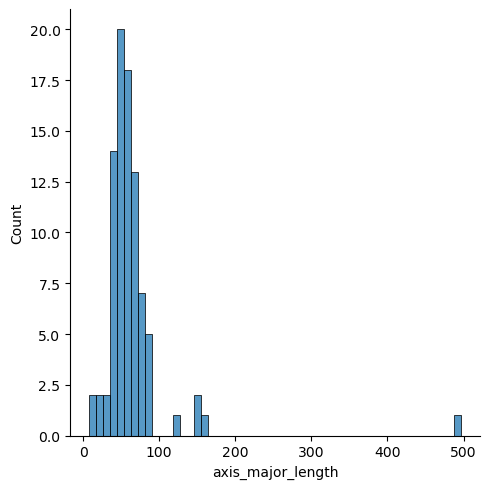

In [24]:
import seaborn as sns
sns.displot(df_after_analysis, x="axis_major_length")

### Before training, filter cell conglomerates or artifacts that have:
* predicted elliptical shapes with outlier `axis_major_lengths` values ("too eliptical / circular shapes") 
* predicted elliptical shapes with outlier `eccentricity` values ("too eliptical /circular shapes") 
* predicted elliptical shapes with outlier `area` values ("Cell conglomerates with high surface area, noise blotches with small surface area") 

In [244]:
# remove outliers AXIS - NON CIRCULAR - ELLIPTICAL SHAPES
df_after_analysis = df_after_analysis[(df_after_analysis["axis_major_length"]< df_after_analysis["axis_major_length"].quantile(.99))]
# remove outliers AREA - CONGLOMERATES
df_after_analysis = df_after_analysis[(df_after_analysis["area"]< df_after_analysis["area"].quantile(.99))&(df_after_analysis["area"]> df_after_analysis["area"].quantile(.01))]
# remove outliers SPHERICITY : CONGLOMERATES WITH MUCH HIGHER eccentricity INDEX VALUES ~ 1
df_after_analysis = df_after_analysis[(df_after_analysis["eccentricity"]< df_after_analysis["eccentricity"].quantile(.90))&(df_after_analysis["eccentricity"]> df_after_analysis["eccentricity"].quantile(.05))]

In [245]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import (
    RobustScaler,
)

print("Performing kmeans...\\n")

df_after_analysis['area_scaled'] = RobustScaler(quantile_range=(5, 95)).fit_transform(df_after_analysis[["area"]])

km = KMeans( n_clusters = 2 ) # 2 clasificaciones
km.fit(df_after_analysis[["area_scaled", "eccentricity"]])
df_after_analysis['predicted'] = km.predict(df_after_analysis[["area_scaled", "eccentricity"]])

    
# save model

pickle.dump(km, open(f"{pwd}\\\\kmeans_bnap.pkl", 'wb')) #Saving the model
    

Performing kmeans...\n


C:\Users\Usuario\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\Usuario\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Text(0, 0.5, 'excentricity')

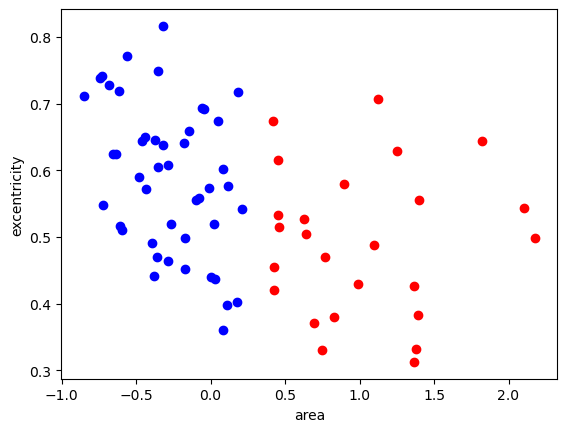

In [254]:
plt.scatter(df_after_analysis[df_after_analysis["predicted"]==0]["area_scaled"], df_after_analysis[df_after_analysis["predicted"]==0]["eccentricity"], c="blue")
plt.scatter(df_after_analysis[df_after_analysis["predicted"]==1]["area_scaled"], df_after_analysis[df_after_analysis["predicted"]==1]["eccentricity"], c="red")
plt.xlabel("area")
plt.ylabel("excentricity")

In [247]:
df_after_analysis

,label,centroid-0,centroid-1,area,eccentricity,axis_major_length,predicted
0,1,2436.327751,746.172249,836.0,0.727558,40.620537,1
1,1,2410.209032,2741.703226,775.0,0.547804,34.671954,1
2,1,2418.252039,481.173592,2575.0,0.532317,62.964286,0
4,1,2349.411765,822.267272,2533.0,0.420688,59.930435,0
6,1,2288.099671,3084.835255,1214.0,0.649738,45.833117,1
...,...,...,...,...,...,...,...
82,1,153.993865,385.946319,1304.0,0.442279,43.199465,1
83,1,148.803248,1964.152668,2155.0,0.402897,55.004863,1
84,1,135.543834,1266.678306,1346.0,0.748386,51.119019,1
85,1,118.101151,2460.670230,1216.0,0.572065,43.594707,1


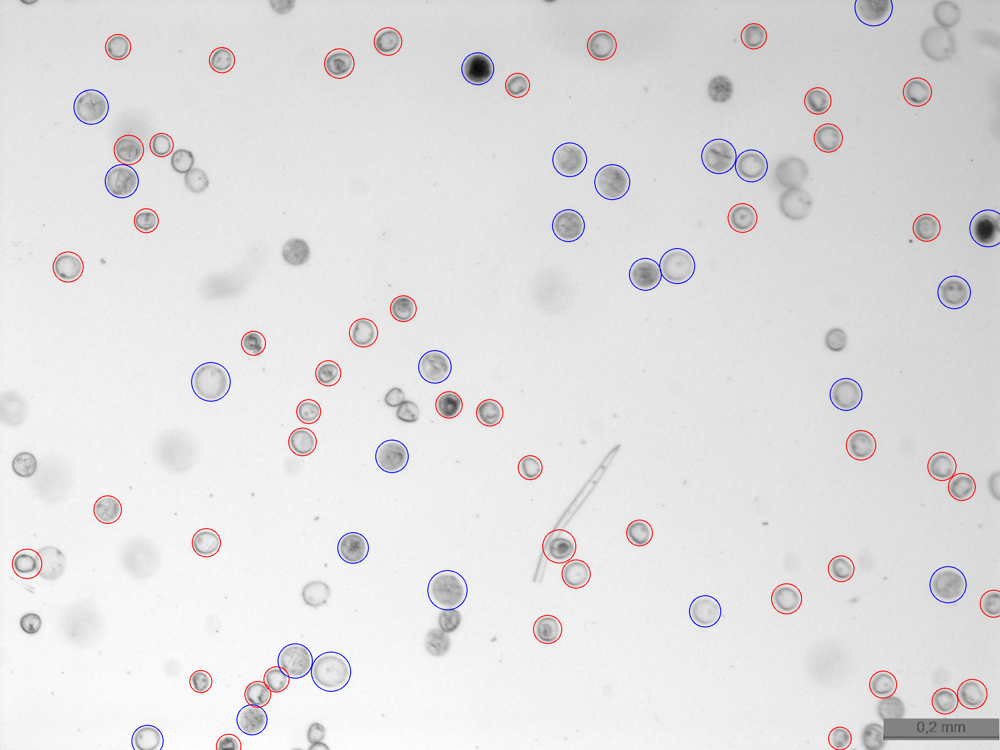

In [248]:
p_image_final = cv2.cvtColor(p_image, cv2.COLOR_GRAY2BGR)


for row_df_final in df_after_analysis.values.tolist():
    centerx= int(row_df_final[1])
    centery = int(row_df_final[2])
    prediction = row_df_final[6]
    r = int(row_df_final[5]/2)
    #if microspore
    if prediction == 0:
        cv2.circle(p_image_final, (centery, centerx), r+20, (0, 0, 255), 2)  # Dibujar círculos rojos en la p_image_final
    else:
        cv2.circle(p_image_final, (centery, centerx), r+20, (255, 0, 0), 2)  # Dibujar círculos rojos en la p_image_final

img = Image.fromarray(p_image_final)

# Display with opencv
img


C:\Users\Usuario\miniconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


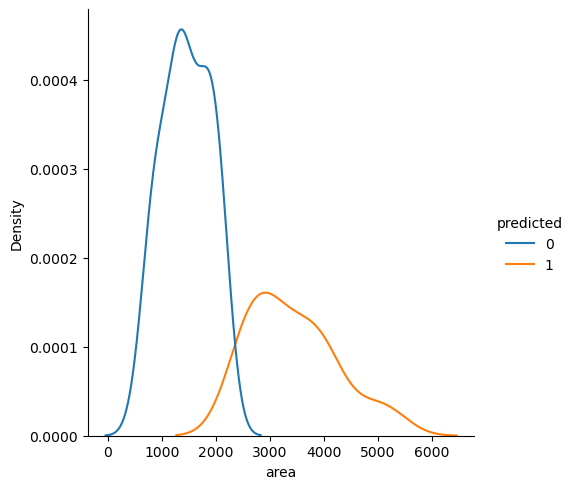

In [264]:
import seaborn as sns
df = df_after_analysis[["area", "predicted"]]
sns.displot(df, x="area", kind="kde", hue="predicted")

C:\Users\Usuario\miniconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


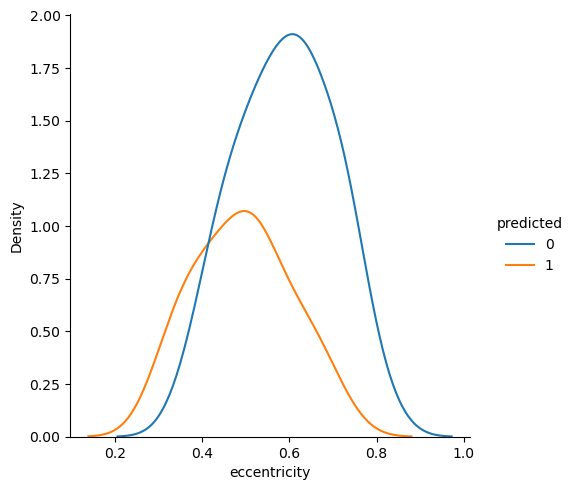

In [265]:
import seaborn as sns
df = df_after_analysis[["eccentricity", "predicted"]]
sns.displot(df, x="eccentricity", kind="kde", hue="predicted")

PROBAR CON MIXTURE GAUSSIAN

In [308]:

# Fit a Dirichlet process Gaussian mixture using two components
dpgmm = mixture.BayesianGaussianMixture(n_components=2, covariance_type="diag", random_state=42).fit(df_after_analysis[["area", "eccentricity"]])
df_after_analysis['predicted'] = dpgmm.predict(df_after_analysis[["area", "eccentricity"]])


C:\Users\Usuario\miniconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


Text(0, 0.5, 'excentricity')

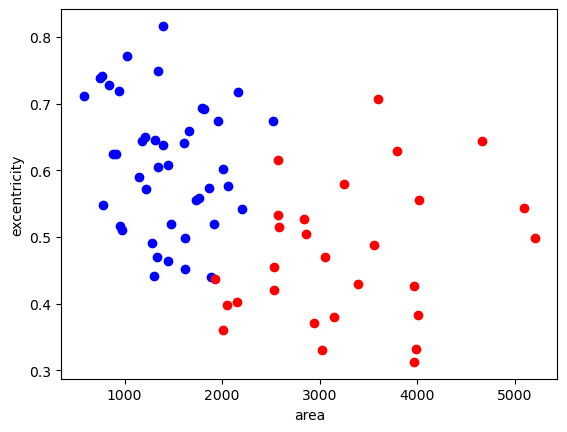

In [309]:
plt.scatter(df_after_analysis[df_after_analysis["predicted"]==0]["area"], df_after_analysis[df_after_analysis["predicted"]==0]["eccentricity"], c="blue")
plt.scatter(df_after_analysis[df_after_analysis["predicted"]==1]["area"], df_after_analysis[df_after_analysis["predicted"]==1]["eccentricity"], c="red")
plt.xlabel("area")
plt.ylabel("excentricity")

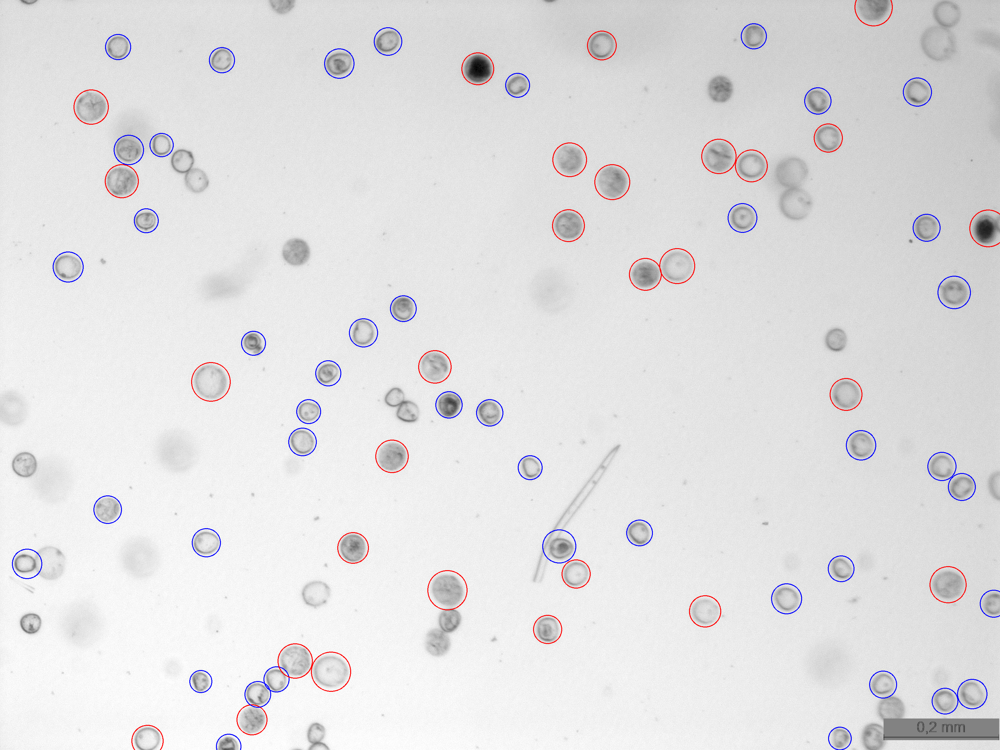

In [310]:
p_image_final = cv2.cvtColor(p_image, cv2.COLOR_GRAY2BGR)


for row_df_final in df_after_analysis.values.tolist():
    centerx= int(row_df_final[1])
    centery = int(row_df_final[2])
    prediction = row_df_final[6]
    r = int(row_df_final[5]/2)
    #if microspore
    if prediction == 0:
        cv2.circle(p_image_final, (centery, centerx), r+20, (0, 0, 255), 2)  # Dibujar círculos rojos en la p_image_final
    else:
        cv2.circle(p_image_final, (centery, centerx), r+20, (255, 0, 0), 2)  # Dibujar círculos rojos en la p_image_final

img = Image.fromarray(p_image_final)

# Display with opencv
img


C:\Users\Usuario\miniconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


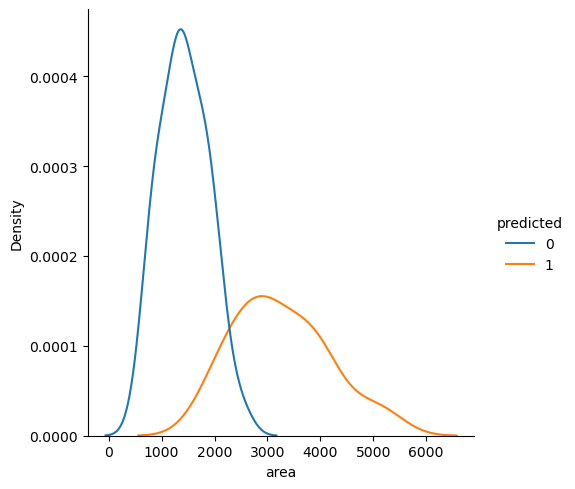

In [311]:
import seaborn as sns
df = df_after_analysis[["area", "predicted"]]
sns.displot(df, x="area", kind="kde", hue="predicted")

In [312]:
df.groupby("predicted").describe()

area                                                            \
          count         mean         std     min      25%     50%     75%   
predicted                                                                   
0          43.0  1428.813953  455.986542   584.0  1087.50  1396.0  1776.5   
1          28.0  3261.821429  889.725803  1929.0  2573.75  3102.0  3967.5   

                   
              max  
predicted          
0          2524.0  
1          5207.0

C:\Users\Usuario\miniconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


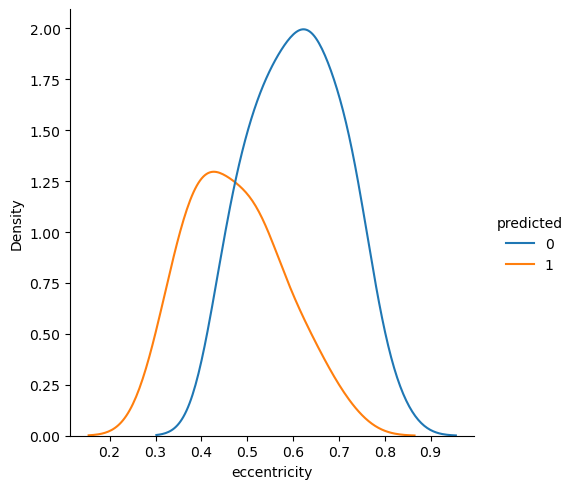

In [313]:
import seaborn as sns
df = df_after_analysis[["eccentricity", "predicted"]]
sns.displot(df, x="eccentricity", kind="kde", hue="predicted")

In [314]:
df.groupby("predicted").describe()

eccentricity                                                    \
                 count      mean       std       min       25%       50%   
predicted                                                                  
0                 43.0  0.609406  0.097867  0.440298  0.530683  0.608394   
1                 28.0  0.473121  0.102904  0.312686  0.394547  0.462385   

                               
                75%       max  
predicted                      
0          0.682602  0.816599  
1          0.535196  0.706258

In [292]:
# guardar d guided mixture gaussian model y kmeans
import pickle
pickle.dump(km, open("cwd/kmeans_cebada_regioprop", 'wb')) #Saving the model
pickle.dump(dpgmm, open("cwd/dpgmm_cebada_regioprop", 'wb')) #Saving the model

# MORE SCIKIT-IMAGE RESOURCES

estimate blur strength
https://scikit-image.org/docs/stable/auto_examples/filters/plot_blur_effect.html

denoising

https://scikit-image.org/docs/stable/auto_examples/filters/plot_denoise.html
https://scikit-image.org/docs/stable/auto_examples/filters/plot_attribute_operators.html

thresholding
https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_multiotsu.html#sphx-glr-auto-examples-segmentation-plot-multiotsu-py
https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_thresholding.html#sphx-glr-auto-examples-segmentation-plot-thresholding-py
regional maxima filtering
https://scikit-image.org/docs/stable/auto_examples/color_exposure/plot_regional_maxima.html
tophat -filter small blobs
https://scikit-image.org/docs/stable/auto_examples/filters/plot_tophat.html

SHAPE INDEXES TO RETRIEVE ROI FEATURES https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_shape_index.html

CLASSIFIES AND DETECTS SHAPES



opencv contornos información sobre esfericidad

esto después de un canny previo a unet?https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_holes_and_peaks.html#sphx-glr-auto-examples-features-detection-plot-holes-and-peaks-py


https://scikit-image.org/docs/stable/auto_examples/features_detection/plot_blob.html#sphx-glr-auto-examples-features-detection-plot-blob-py

rolling ball background https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_rolling_ball.html#sphx-glr-auto-examples-segmentation-plot-rolling-ball-py